In [ ]:
from pathlib import Path
import numpy as np
import cv2
import matplotlib.pyplot as plt

from retrievalnet.evaluation import retrieval, is_gt_match_2D
from retrievalnet.datasets.nclt import Nclt
from retrievalnet.settings import DATA_PATH, EXPER_PATH
from utils import plot_imgs
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [4]:
experiment = 'mobilenetvlad_depth-0.35'
camera = 4
ref_seq = '2012-01-08'
query_seq = '2013-02-23'

In [38]:
base_dir = Path(DATA_PATH, 'nclt')
def imread(seq, name):
    im_dir = Path(base_dir, '{}/lb3/Cam{}/'.format(seq, camera))
    return np.rot90(cv2.imread(str(Path(im_dir, '{}.tiff'.format(name)))), k=3)
def get_data(seq, experiment):
    im_poses = Nclt.get_pose_file(seq)
    descriptors = []
    for t in im_poses['time']:
        descriptors.append(np.load(
            Path(EXPER_PATH, 'exports', experiment, seq, str(t)+'.npy')))
    return im_poses, np.array(descriptors)
def add_frame(im, c, b=40):
    im[:, :b] = c
    im[:, -b:] = c
    im[:b, :] = c
    im[-b:, :] = c

In [37]:
ref_poses, ref_descriptors = get_data(ref_seq, experiment)
query_poses, query_descriptors = get_data(query_seq, experiment)
gt_matches = is_gt_match_2D(query_poses, ref_poses, distance_thresh=15, angle_thresh=70*np.pi/180)
valid = np.any(gt_matches, axis=1)
retrieved_indices = retrieval(ref_descriptors, query_descriptors, max_num_nn=5, pca_dim=512)

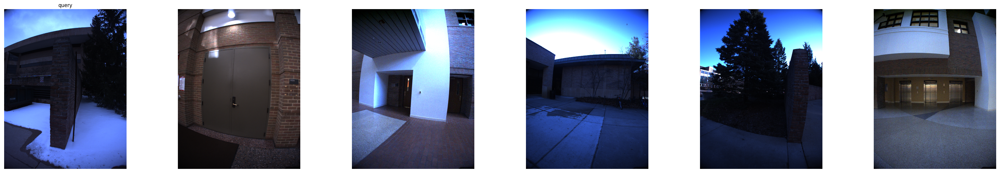

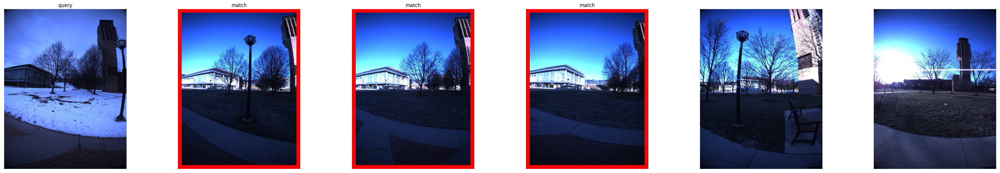

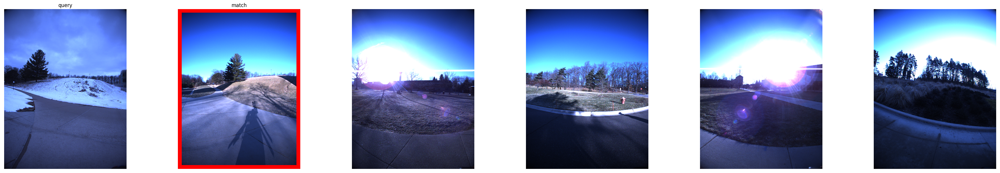

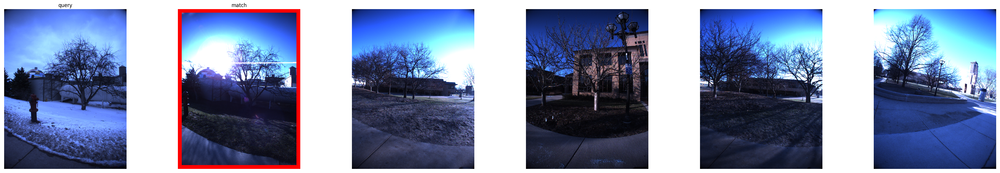

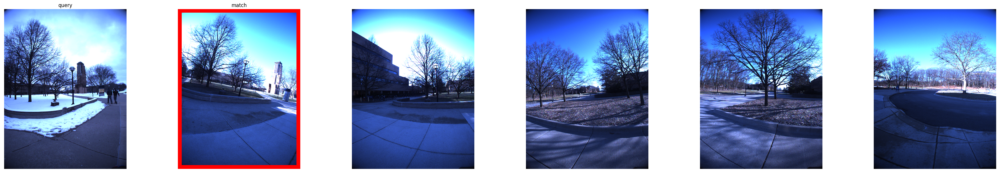

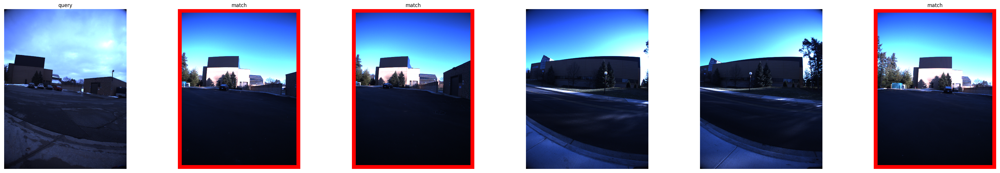

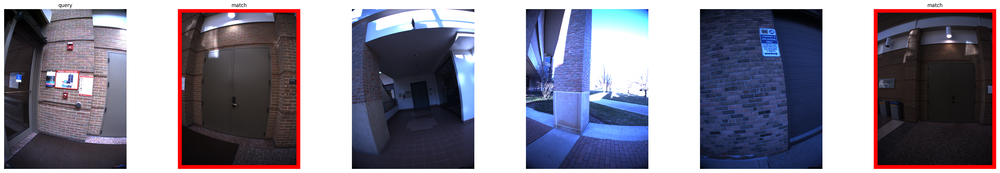

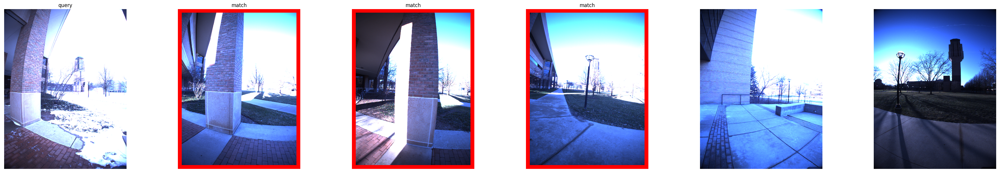

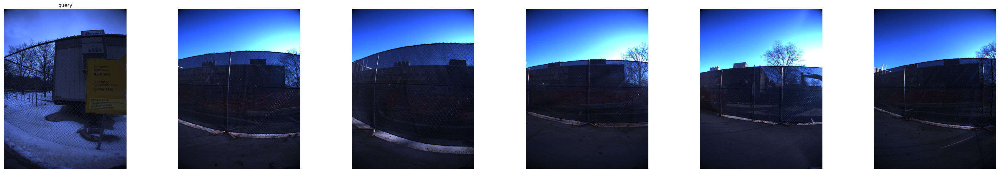

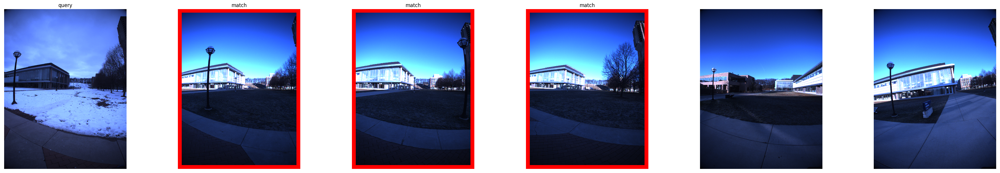

In [40]:
n_test = 10
test_idx = np.random.choice(range(valid.sum()), size=n_test)
for idx in test_idx:
    disp = [imread(query_seq, query_poses['time'][valid][idx])]
    titles = ['query']
    for i in retrieved_indices[valid][idx]:
        im = imread(ref_seq, ref_poses['time'][i])
        if gt_matches[valid][idx][i]:
            add_frame(im, (0, 0, 255))
            titles.append('match')
        else:
            titles.append('')
        disp.append(im)
    plot_imgs(disp, titles=titles)